**Importing Required Libraries**

In [1]:
import plotly.graph_objs as go
import plotly.subplots as sp
import numpy as np
from scipy.interpolate import interp1d

# Loading Words

In [15]:
with open('words.txt') as file:
    words = file.read().splitlines()

In [16]:
def get_scale_logits(logits, temperature):
    return logits / temperature

In [17]:
def get_probability(logits):
    exponentiated_logits = np.exp(logits)
    return exponentiated_logits / exponentiated_logits.sum()

In [45]:
colors = {
    'logits_bar': 'rgba(215, 101, 139, 1)',
    'pmf_bar': 'rgba(89, 158, 148, 1)',
    'pmf_scatter_contour': 'rgba(226, 124, 124, 1)',
    'pmf_scatter_fill': 'rgba(226, 124, 124, 0.1)',
    'deselected': 
}

# (Randomly) Creating Vocabulary

In [46]:
cardinality = 200

np.random.seed(1618)
vocab = np.sort(np.random.choice(words, size=cardinality, replace=False))
logit_values = np.random.normal(0, 0.8, size=cardinality)
pmf_values = get_probability(logit_values)
pdf = interp1d(np.arange(len(vocab)), pmf_values, kind='cubic', fill_value='extrapolate')

# Plotting Distribution

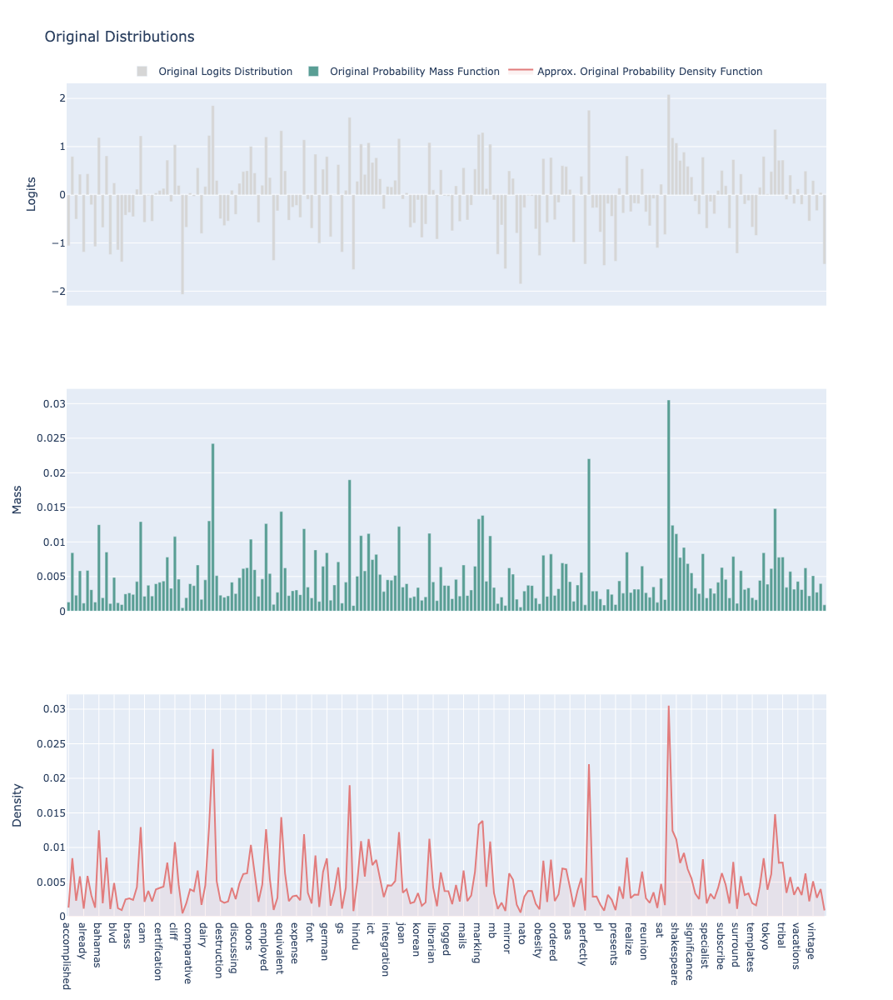

In [47]:
# Create figure
fig = sp.make_subplots(rows=3, cols=1, shared_xaxes=True)

# Add logits trace
fig.add_trace(
    go.Bar(
        x=vocab,
        y=logit_values,
        name='Original Logits Distribution',
        marker={
            'color': colors['logits_bar']
        }
    ), row=1, col=1
)
fig.update_yaxes(title_text='Logits', row=1, col=1)


# Adding PMF trace
fig.add_trace(
    go.Bar(
        x=vocab,
        y=pmf_values,
        name='Original Probability Mass Function',
        marker={
            'color': colors['pmf_bar']
        }
    ), row=2, col=1
)
fig.update_yaxes(title_text='Mass', row=2, col=1)

# Adding PDF trace
fig.add_trace(
    go.Scatter(
        x=vocab,
        y=pmf_values,
        name='Approx. Original Probability Density Function',
        marker={
            'color': colors['pmf_scatter_contour']
        },
        fill='tozeroy',
        fillcolor=colors['pmf_scatter_fill']
    ), row=3, col=1
)
fig.update_yaxes(title_text='Density', row=3, col=1)

fig.update_layout(
    title='Original Distributions',
    showlegend=True,
    legend=dict(
        x=0.5,
        y=1.0,
        xanchor='center',
        yanchor='bottom',
        orientation='h'
    ),
    width=1000,
    height=1200
)

# Show plot
fig.show()

# Plotting Effect of Temperature on Distribution

In [27]:
# Creating temperature schedule
step = 0.01
max_temperature = 5
temperature_schedule = np.arange(0 + step, 5 + step, step)
initial_frame_index = np.where(temperature_schedule == 1)[0]

In [28]:
# Create figure
fig = sp.make_subplots(rows=3, cols=1, shared_xaxes=True)

t = min(max(temperature_schedule.min(), 1), temperature_schedule.max())
scaled_logit_values = get_scale_logits(logit_values, t)
pmf_values = get_probability(scaled_logit_values)

# Add logits trace
fig.add_trace(
    go.Bar(
        x=vocab,
        y=scaled_logit_values,
        name='Temperature-Scaled Logits Distribution',
        marker={
            'color': colors['logits_bar']
        }
    ), row=1, col=1
)
fig.update_yaxes(title_text='Logits', row=1, col=1)


# Adding PMF trace
fig.add_trace(
    go.Bar(
        x=vocab,
        y=pmf_values,
        name='Temperature-Scaled Probability Mass Function',
        marker={
            'color': colors['pmf_bar']
        }
    ), row=2, col=1
)
fig.update_yaxes(title_text='Mass', row=2, col=1)

# Adding PDF trace
fig.add_trace(
    go.Scatter(
        x=vocab,
        y=pmf_values,
        name='Temperature-Scaled Approx. Probability Density Function',
        marker={
            'color': colors['pmf_scatter_contour']
        },
        fill='tozeroy',
        fillcolor=colors['pmf_scatter_fill']
    ), row=3, col=1
)
fig.update_yaxes(title_text='Density', row=3, col=1)

fig.update_layout(
    title='Effect of Temperature on Distribution',
    showlegend=True,
    legend=dict(
        x=0.5,
        y=1.0,
        xanchor='center',
        yanchor='bottom',
        orientation='h'
    ),
    width=1000,
    height=1000
)

# Create frames for the animation
frames = []
for t in temperature_schedule:

    scaled_logit_values = get_scale_logits(logit_values, t)
    pmf_values = get_probability(scaled_logit_values)
    
    frame = go.Frame(
        data=[
            go.Bar(
                x=vocab,
                y=scaled_logit_values,
                name='Temperature-Scaled Logits Distribution',
                marker={
                    'color': colors['logits_bar']
                }
            ),
            go.Bar(
                x=vocab,
                y=pmf_values,
                name='Temperature-Scaled Probability Mass Function',
                marker={
                    'color': colors['pmf_bar']
                }
            ),
            go.Scatter(
                x=vocab,
                y=pmf_values,
                name='Temperature-Scaled Approx Probability Density Function',
                marker={
                    'color': colors['pmf_scatter_contour']
                },
                fill='tozeroy',
                fillcolor=colors['pmf_scatter_fill']
            )
        ],
        layout=go.Layout(
            yaxis1={'range': [scaled_logit_values.min() * 1.1, scaled_logit_values.max() * 1.1]},
            yaxis2={'range': [0, pmf_values.max() * 1.1]},
            yaxis3={'range': [0, pmf_values.max() * 1.1]}
        ),
        name=f'Temperature = {round(t, 2)}'
    )

    frames.append(frame)
fig.frames = frames

# Update layout with animation settings
fig.update_layout(
    updatemenus=[{
        'buttons': [
            {
                'args': [None, {'frame': {'duration': 500, 'redraw': True}, 'mode': 'immediate'}],
                'label': 'Play',
                'method': 'animate'
            },
            {
                'args': [[None], {'frame': {'duration': 0, 'redraw': True}, 'mode': 'immediate'}],
                'label': 'Pause',
                'method': 'animate'
            }
        ],
        'direction': 'left',
        'showactive': False,
        'type': 'buttons',
        'x': 0.5,
        'y': -0.2,
        'xanchor': 'center',
        'yanchor': 'top'
    }],
    sliders=[{
        'active': initial_frame_index.item(),
        'currentvalue': {'prefix': 'Temperature: '},
        'len': 1.0,
        'x': 0,
        'y': -0.25,
        'steps': [{
            'args': [
                [f'Temperature = {round(t, 2)}'],
                {'frame': {'duration': 0, 'redraw': True}, 'mode': 'immediate'}
            ],
            'label': round(t, 2),
            'method': 'animate'
        } for t in temperature_schedule]
    }],
    yaxis={'autorange': True}
)

# Show the plot
fig.show()

# Sampling

## Hyperparameters


In [29]:
t = 0.8
scaled_logit_values = get_scale_logits(logit_values, t)
pmf_values = get_probability(scaled_logit_values)
sorted_vocab, sorted_scaled_logit_values, sorted_pmf_values = zip(*sorted(zip(vocab, scaled_logit_values, pmf_values), key=lambda x: x[-1], reverse=True))

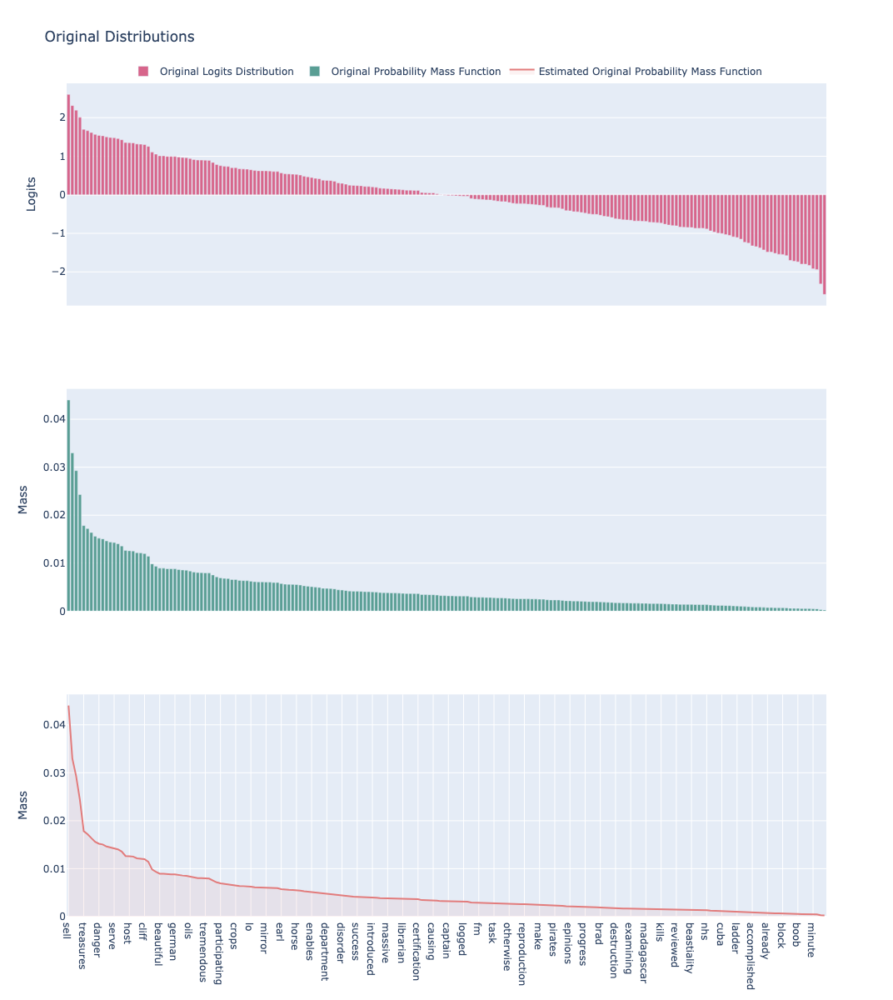

In [30]:
# Create figure
fig = sp.make_subplots(rows=3, cols=1, shared_xaxes=True)

# Add logits trace
fig.add_trace(
    go.Bar(
        x=sorted_vocab,
        y=sorted_scaled_logit_values,
        name='Original Logits Distribution',
        marker={
            'color': colors['logits_bar']
        }
    ), row=1, col=1
)
fig.update_yaxes(title_text='Logits', row=1, col=1)


# Adding PMF trace
fig.add_trace(
    go.Bar(
        x=sorted_vocab,
        y=sorted_pmf_values,
        name='Original Probability Mass Function',
        marker={
            'color': colors['pmf_bar']
        }
    ), row=2, col=1
)
fig.update_yaxes(title_text='Mass', row=2, col=1)

# Adding PDF trace
fig.add_trace(
    go.Scatter(
        x=sorted_vocab,
        y=sorted_pmf_values,
        name='Estimated Original Probability Mass Function',
        marker={
            'color': colors['pmf_scatter_contour']
        },
        fill='tozeroy',
        fillcolor=colors['pmf_scatter_fill']
    ), row=3, col=1
)
fig.update_yaxes(title_text='Mass', row=3, col=1)

fig.update_layout(
    title='Original Distributions',
    showlegend=True,
    legend=dict(
        x=0.5,
        y=1.0,
        xanchor='center',
        yanchor='bottom',
        orientation='h'
    ),
    width=1000,
    height=1200
)

# Show plot
fig.show()